<a href="https://colab.research.google.com/github/MinahilRaza/Tennis-Ball-Tracking/blob/main/CamShiftforPlayerTracking.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

This notebook uses camshift to track players in a tennis match video

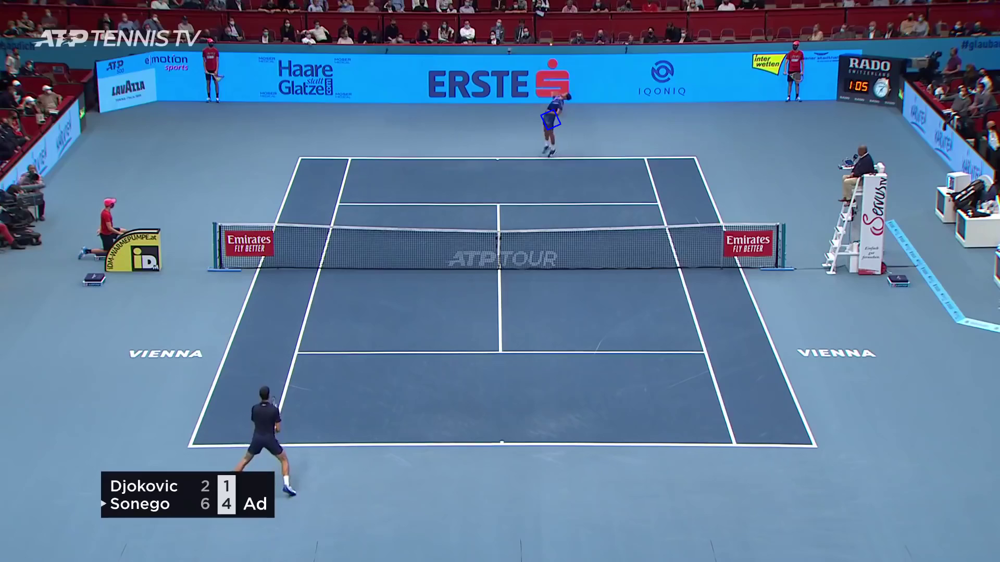

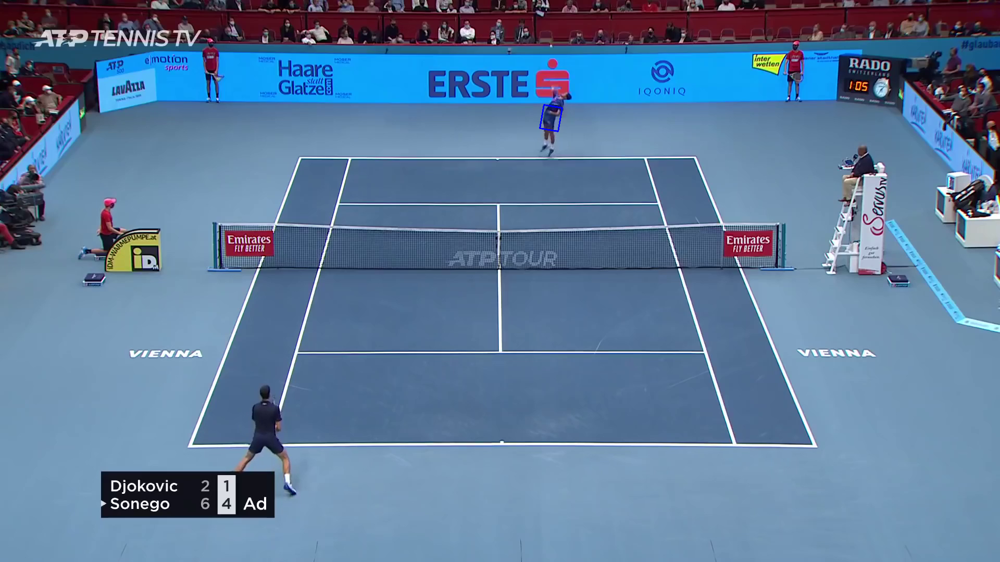

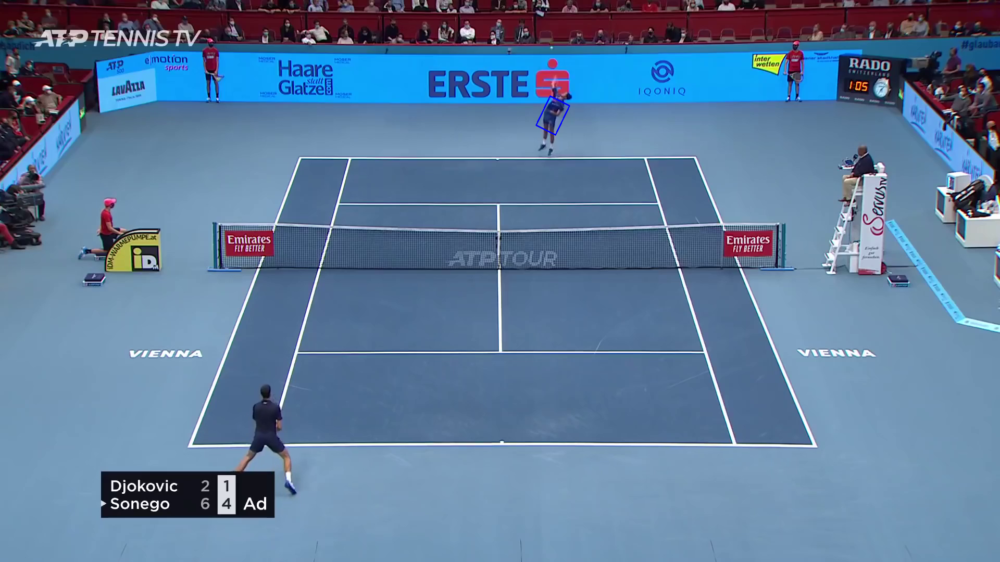

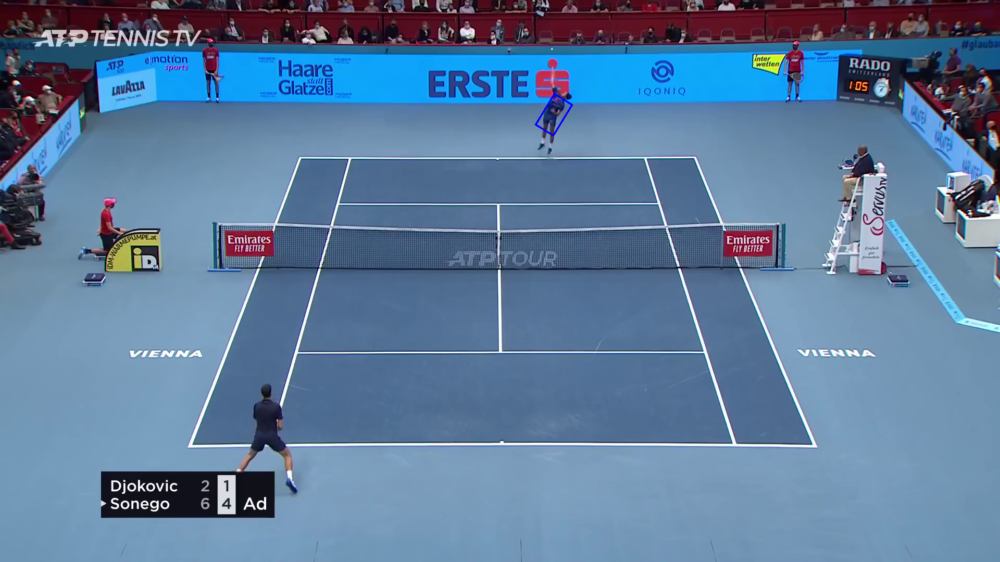

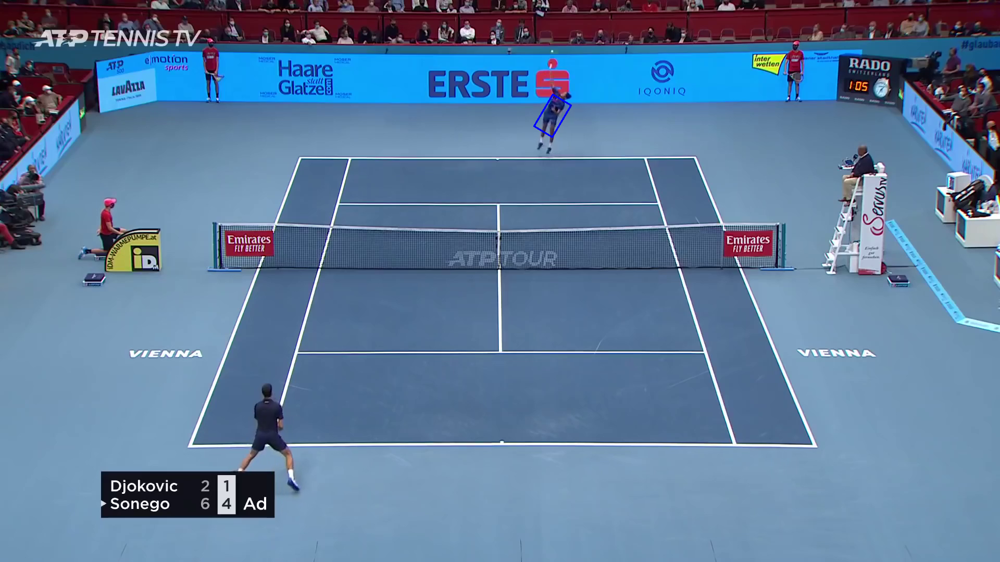

...

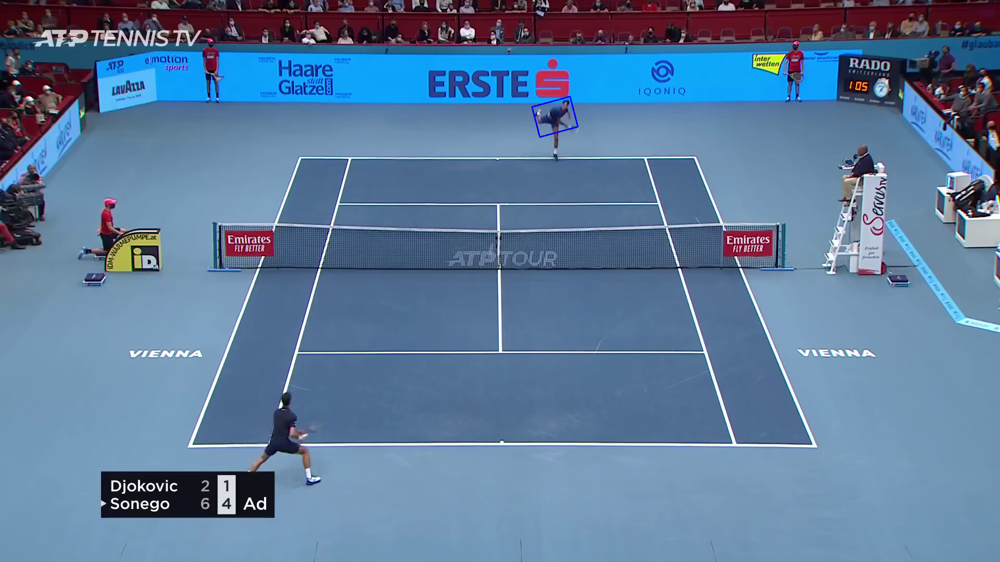

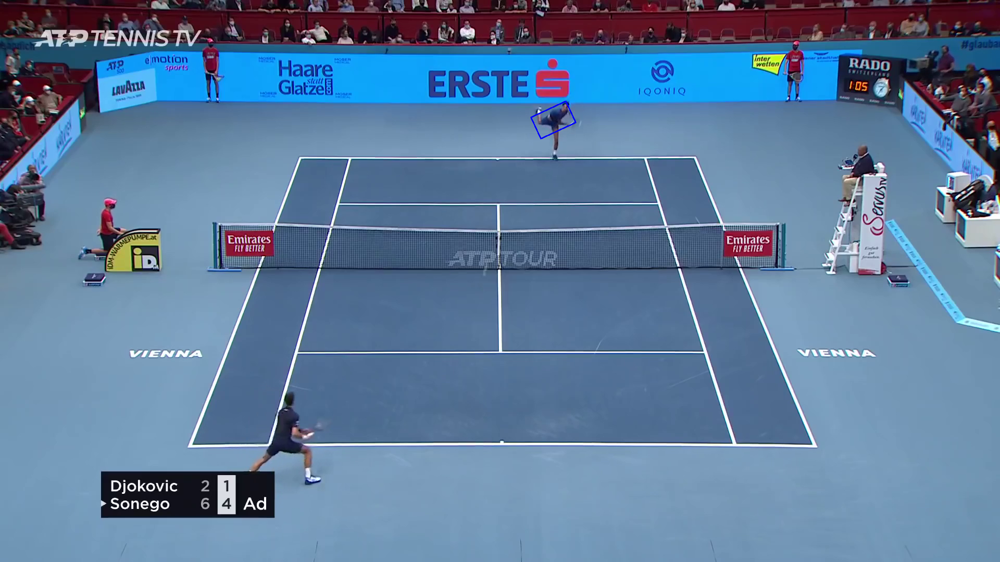

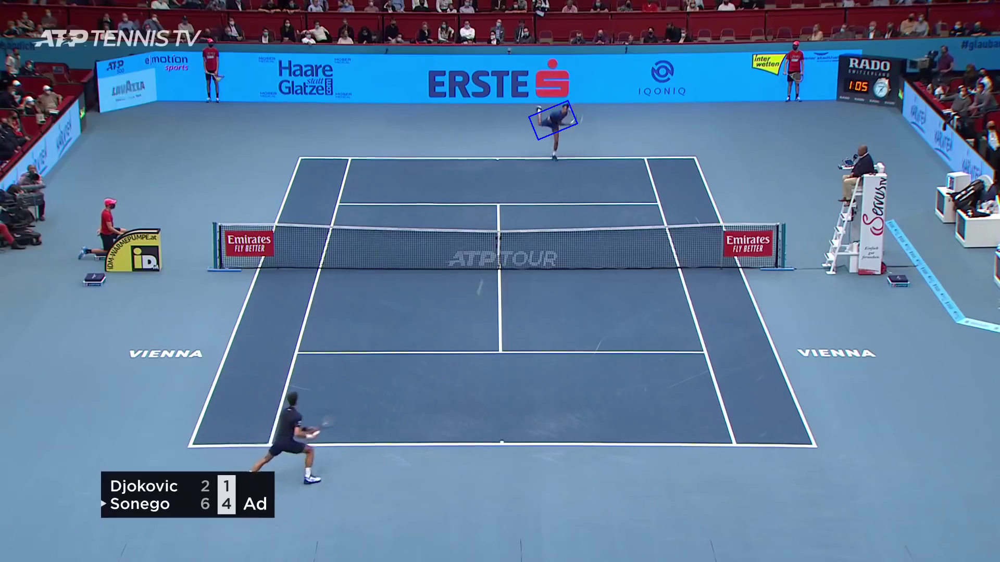

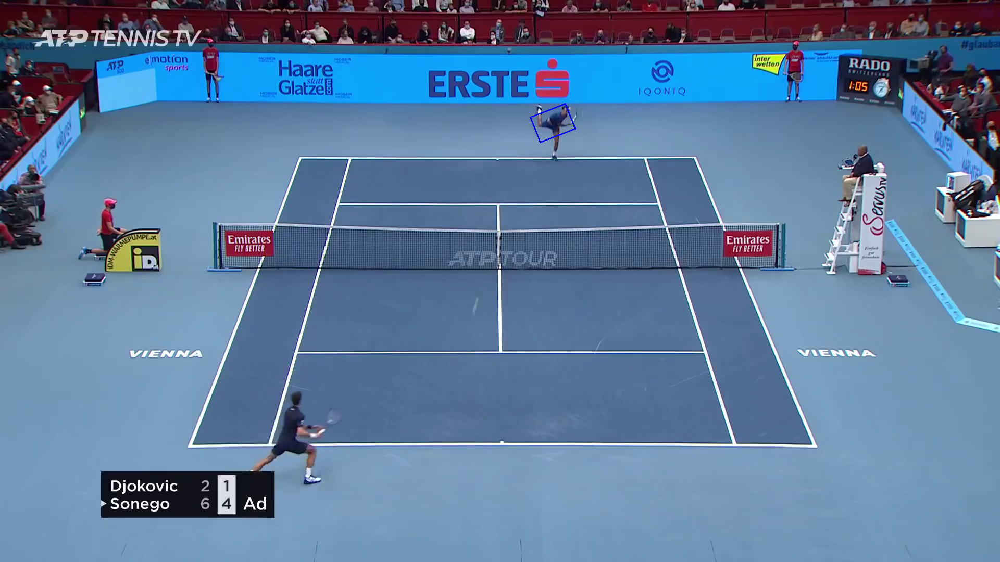

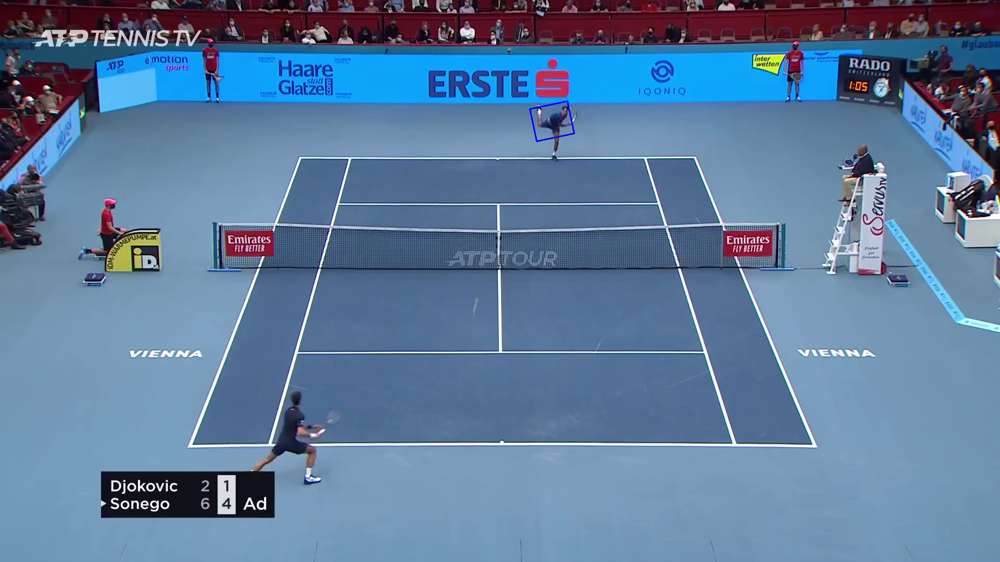

In [1]:
import numpy as np
import cv2 as cv
from google.colab.patches import cv2_imshow
cap = cv.VideoCapture('video_cut.mp4') #486, 748

# take first frame of the video
ret,frame = cap.read()

# first player
y,x = 800, 500
h =  20
w = 20

# Second Player
x,y =  1050, 220
h,w = 20,20
track_window = (x, y, w, h)


# set up the ROI for tracking
roi = frame[y:y+h, x:x+w]
hsv_roi = cv.cvtColor(roi, cv.COLOR_BGR2HSV)
mask = cv.inRange(hsv_roi, np.array((0., 60.,32.)), np.array((180.,255.,255.)))
roi_hist = cv.calcHist([hsv_roi],[0],mask,[180],[0,180])
cv.normalize(roi_hist,roi_hist,0,255,cv.NORM_MINMAX)
# Setup the termination criteria, either 10 iteration or move by at least 1 pt
term_crit = ( cv.TERM_CRITERIA_EPS | cv.TERM_CRITERIA_COUNT, 10, 1 )

i = 0
while(1):
  ret, frame = cap.read()
  i += 1
  if i>25:
    break
  if ret == True:
      hsv = cv.cvtColor(frame, cv.COLOR_BGR2HSV)
      dst = cv.calcBackProject([hsv],[0],roi_hist,[0,180],1)
      # apply camshift to get the new location
      ret, track_window = cv.CamShift(dst, track_window, term_crit)
      # Draw it on image
      pts = cv.boxPoints(ret)
      pts = np.int0(pts)
      img2 = cv.polylines(frame,[pts],True, 255,2)
      cv2_imshow(img2)
      k = cv.waitKey(30) & 0xff
      if k == 27:
        break
  else:
      break


Notes: Camshift is better than meanshift because you can detect rotations and shift. It is faster than Kalman filter and particle filter. However, it dosn't work for occlusions.